### <span style="background-color: #00FFFF">Recap</span>
In the first part of the lecture we have introduced and analysed the properties of two families of random graphs:
- (undirected) **Erdos-Renyi** graph, which is a graph whose links are uniformly random;
- **small world** graphs, in which there is a large fraction of short range links plus a small fraction of random long range links.

Specifically:
- we have shown that both in the Erdos-Renyi and in the small world graphs the **diameter** scales sublinearly with $n$ (specifically, with $log(n)$);
- we have seen that the **degree distribution** of the graphs (for ER this holds $p \propto 1/n$ if is Poisson-like), i.e., it has small variance.
- we have compared the **clustering coefficient** of the two models, i.e., the number of triangles in the graph, showing that in Erdos-Renyi graph the clustering coefficient is much smaller than in the small world graphs.

In the next part we consider a real citation network, and compare how well the random graphs approximate the citation network.
By doing so, we introduce the **preferential attachment model** and the **configuration model** and complete our analysis on random graphs.

## <span style="background-color: #00FF00">Preferential attachment model</span>

This is a model of growing graph. The idea is the following (we consider the undirected case):

- we start at time $t=0$ with an initial undirected graph $\mathcal{G}_0$;
- at each time $t \in \{1,2,...\}$, we create a new graph $\mathcal{G}_t$ obtained by adding a new node to $\mathcal{G}_{t-1}$, and connecting such a node to $c$ nodes randomly selected. 

If the nodes are selected with uniform probability, we call the model **uniform attachment model**. The more interesting case is when the nodes are selected with a probability which depends on the degree of the nodes, which is called **preferential attachment model**. Several models of preferential attachment may be defined.

In the model introduced by **Price**, the probability for a new node introduced at time $t$ of attaching to a node $i$ is proportional to $a + w_i(t-1)$, where $a > -1$, and $w_i(t-1)$ indicates the degree of node $i$ at time $t-1$.

In the particular case $a=0$ the model is known as **Barabasi-Albert** model.

### Degree distribution of a preferential attachment model
It can be proven that, as $n \to +\infty$, the degree distribution of the Barabasi-Albert model ($a=0$), if each new node attachs to $c$ nodes, follows a power-law distribution, specifically,

$$
p_k =
\begin{cases}
0 \quad &\text{if} \ k<c\\
\frac{2}{2+c} &\text{if} \ k=c\\
\frac{2c(c+1)}{k(k+1)(k+2)} &\text{if} \ k>c.
\end{cases}
$$

Asymptotically for large $k$, this means that $p_k \propto k^{-3}$, which is a power law with exponential $\gamma=3$.

For the more general Price model, it can be proven that for large $k$, $p_k \propto k^{-(3+a)}$.

**Generalizations of preferential attachment model**: 
- this model can be generalized to the case of directed networks, by assuming that the probability of connecting to a node $i$ depends on its indegree $w_i^-$;
- the model can be also generalized by assuming that the number of outlinks of each node is a random variable. This allows to obtain different out-degree distribution (otherwise in directed model all the nodes would have the same out-degree).

We will study other properties of preferential attachment model (e.g., the diameter) in the next part.

# <span style="background-color: #FF7F50">Random graphs as a model for a citation network
The real world network in this problem is a citation network with 10000 papers. It can be loaded with the following code.

In [14]:
citation = sio.loadmat('citation1.mat', variable_names=['citation'])
citation = citation['citation']

This is a directed network where each node represents a paper and a link from node i to j means that paper i cited paper j. The variable `citation` is an array with 3 columns. Each row contains the tail and head node of a link and the weight associated to such link in the adjacency matrix of the graph (in this case, the weight is either 1 or 0). The graph is constructed from the `citation` variable as follows:

In [15]:
G = nx.DiGraph()

for i,j,w in citation:
    if w != 0:
        G.add_edge(i,j)

n_nodes_cit = nx.number_of_nodes(G)
n_links_cit = nx.number_of_edges(G)

In the following, we analyze how to approximate the citation graph with different random graph models. We then compare the obtained approximations to see which one is the best for this example.

Let $n_C$ and $l_C$ be the number of nodes and links in the citation network.

In [16]:
printmd("$n_C = " + str(n_nodes_cit) + "$")
printmd("$l_C = " + str(n_links_cit) + "$")

$n_C = 2191$

$l_C = 4212$

## <span style="background-color: #FFD700">Erdos-Renyi-model</span>
To approximate the citation network we construct an Erdos-Renyi-model with as many nodes as the real network, that is $n$. Remember that the expected number of links in Erdos-Renyi undirected graphs is $\binom{n}{2}p$ where $p$ is the probability of there being a link between any two distinct nodes i and j. We choose $p$ such that the expected number of links is the same as the number of links in the actual citation network. By construction, this random graph will not have any self loop.

**Remark**: we here construct a directed Erdos-Renyi graph, since the citation graph is directed. The generalization is straightforward: instead of adding undirected links $\{i,j\}$ with probability $p$, here we add a directed link $(i,j)$ with probability $p$. Thus, the average in-degree and out-degree are both $(n-1)p$, and the expected number of links is $n(n-1)p=2\binom{n}{2}p$, where $\binom{n}{2}p$ is the expected number of undirected links in the undirected Erdos-Renyi graph with $n$ nodes and link probability $p$.

Let $n_{ER}$ and $l_{ER}$ be the number of nodes and expected of links in Erdos-Renyi graph.

Thus, $n_{ER} = n_{C}$ and $l_{ER} = l_{C} \implies l_{ER} = 2\binom{n_C}{2}p \implies p=\frac{l_{ER}}{2\binom{n_{C}}{2}}$ 

In [17]:
# Construction of the Erdos-Renyi model

# choose p so that the expected number of links is the same as n_links_cit
# factor 2 at denominator is because G is directed
p = n_links_cit/(sp.special.binom(n_nodes_cit,2) * 2) 
# add links between couple of different nodes with probability p
WER = np.random.choice([0,1], size=(n_nodes_cit, n_nodes_cit), p= [1-p,p])
# GER has no self loops
for n in range(n_nodes_cit):
    WER[n,n] = 0
    
GER = nx.from_numpy_array(WER, create_using=nx.DiGraph)

## <span style="background-color: #FFD700">The configuration model</span>
Here we construct a configuration model to approximate the citation network. To do this, we proceed as follows: given the in and out-degree of the real network, we pick uniformly at random one out-link and one in-link and connect them.

In this model, we are able to reproduce the exact in-degree and out-degree distribution.

Instead, in the ER graph, we imposed that the average degree is the same as in the citation graph, but the resulting degree distribution is approximately a Poisson distribution independently of the original degree distribution.

In [18]:
# Construction of the Configuration model
WCM = np.zeros((n_nodes_cit, n_nodes_cit))
# G.out_degree() is a list of tuples in the form (node,degree)
# we select degree and append to array of degrees
residual_out_degree = np.array(list(degree for node, degree in G.out_degree()))

# same for the indegree
residual_in_degree = np.array(list(degree for node, degree in G.in_degree()))

print(residual_out_degree)

[2 0 2 ... 0 1 0]


In [19]:
# for each node
for i in range(n_nodes_cit):
    # while there are unconnected out "half links" starting from the node
    while residual_out_degree[i] > 0:
        available_targets = np.arange(n_nodes_cit)
        # randomly connect the half link to node j, so that the link is (i,j)
        # the probability of connecting to j is proportional to the residual_indegree of j
        target = np.random.choice(available_targets, p = residual_in_degree/sum(residual_in_degree))
        WCM[i,target] = 1
        # decrease out/in degree of the connected nodes
        residual_in_degree[target] -=1
        residual_out_degree[i] -=1

GCM = nx.from_numpy_array(WCM, create_using=nx.DiGraph)

## <span style="background-color: #FFD700">Preferential attachment model</span>
The preferential attachment is a model for growing random graphs which was explicitly introduced to model citation networks. We now explore this model to see if it is capable of approximating the real citation network.

We generate a random graph by the preferential attachment model, so that the final number of nodes n is the same as in the real citation network and so that the degree distrubution is similar. To do this, we start with directed graph $G_0$ containing 2  nodes connected to each other.

At timestep $t$ $(t\geq1)$, we add a new node to the graph and connect it to $c$ other nodes already present in $G_{t}$, the resulting graph is called $G_{t+1}$. 

The value of $c$ is chosen randomly with probabilities according to the out-degree distribution of the real citation network, so that we obtain the correct out-degree distribution. 

For each of the $c$ new connections, the destination node is chosen with probability proportional to the in-degree distribution of $G_{t}$ plus a constant $a$ , so that the probability that node $i$ is chosen is given by

$$
p_i(t)=\frac{w_i^-(t) + a}{\sum_j (w_j^-(t)+a)}.
$$

**Remark**: when $a \neq 0$, each node has an intrinsic probability of being selected as a neighbor from new nodes, regardless of its in-degree. Observe that each node enters in the network with in-degree $0$. Thus, in the directed Price model $a > 0$, otherwise none of the nodes added at time $t \ge 1$ cannot be chosen by new nodes and cannot increase their indegree.

The process stops when the total number of nodes $n$ is reached.

Degree values in the network: (32, 23, 22, 20, 17, 16, 15, 14, 13, 12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1, 0)
Counter for each degree (1, 1, 1, 1, 2, 1, 1, 2, 7, 3, 8, 12, 13, 31, 29, 48, 64, 136, 213, 340, 648, 629)
Degree frequency [0.00045641 0.00045641 0.00045641 0.00045641 0.00091283 0.00045641
 0.00045641 0.00091283 0.00319489 0.00136924 0.0036513  0.00547695
 0.00593336 0.01414879 0.01323597 0.0219078  0.02921041 0.06207211
 0.09721588 0.15518028 0.29575536 0.28708352]


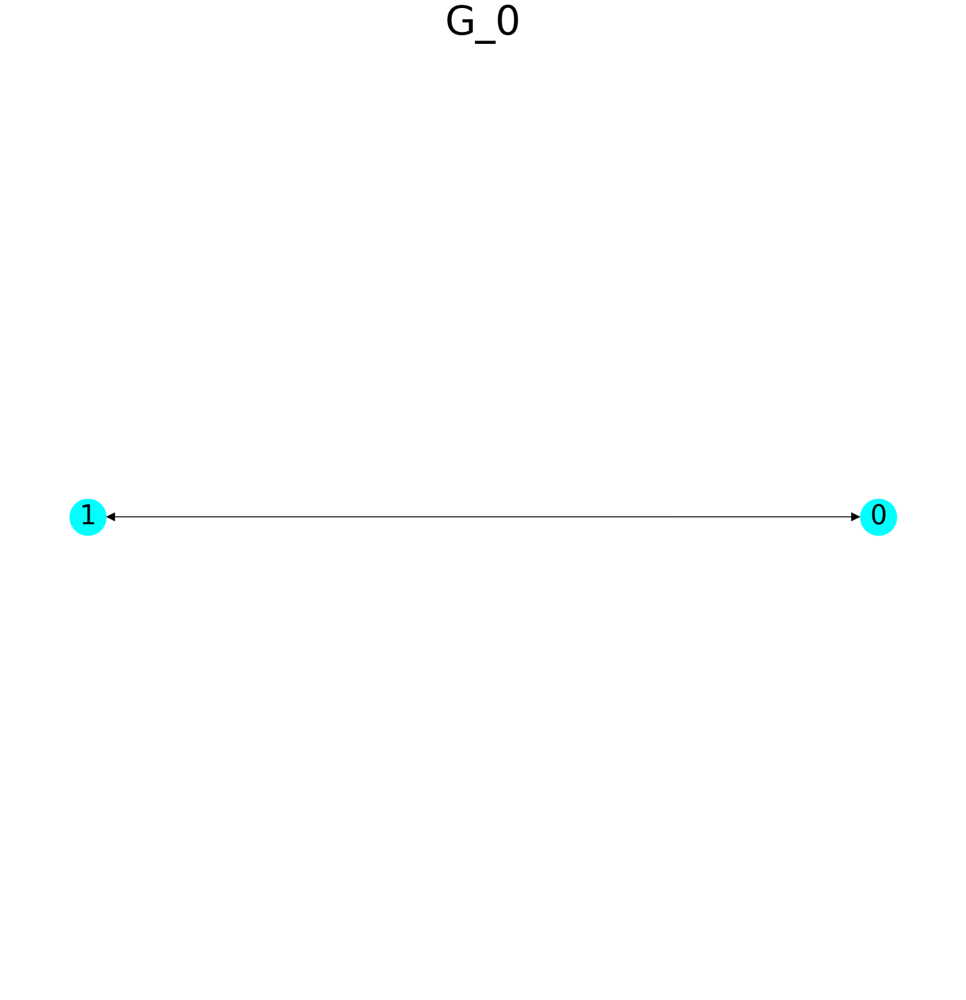

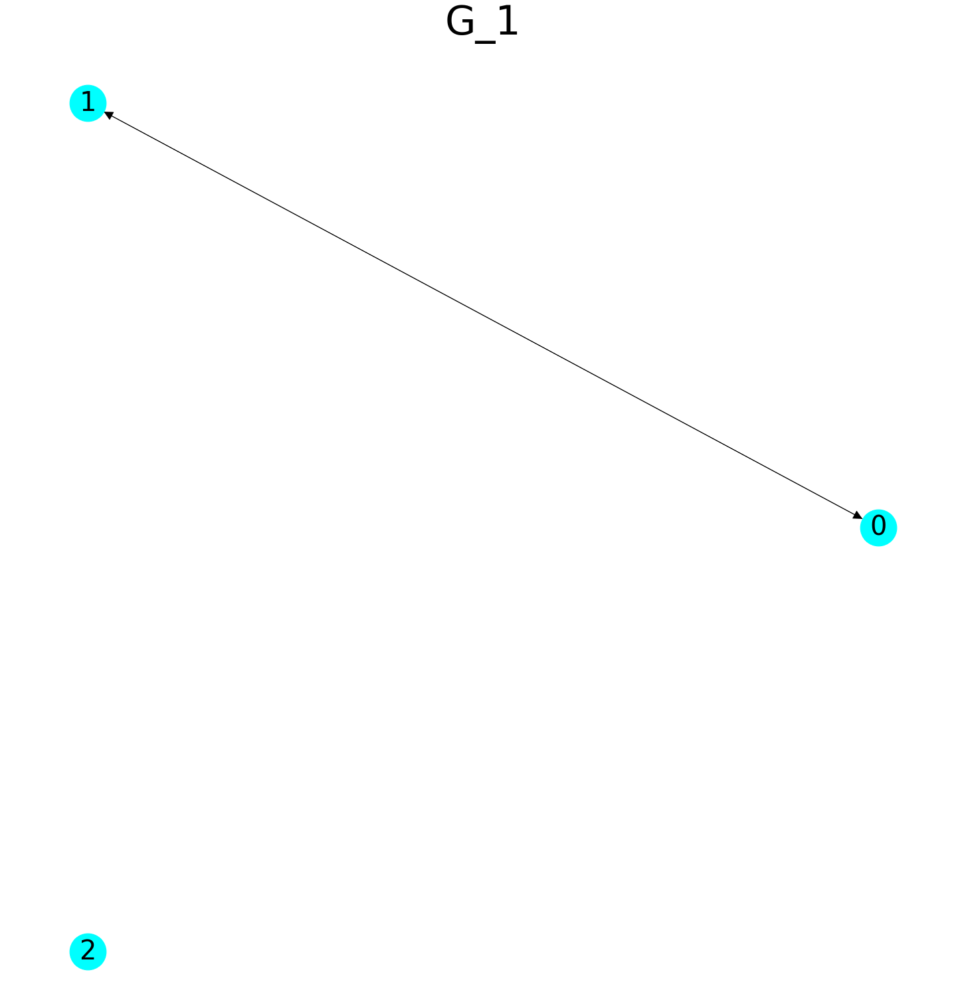

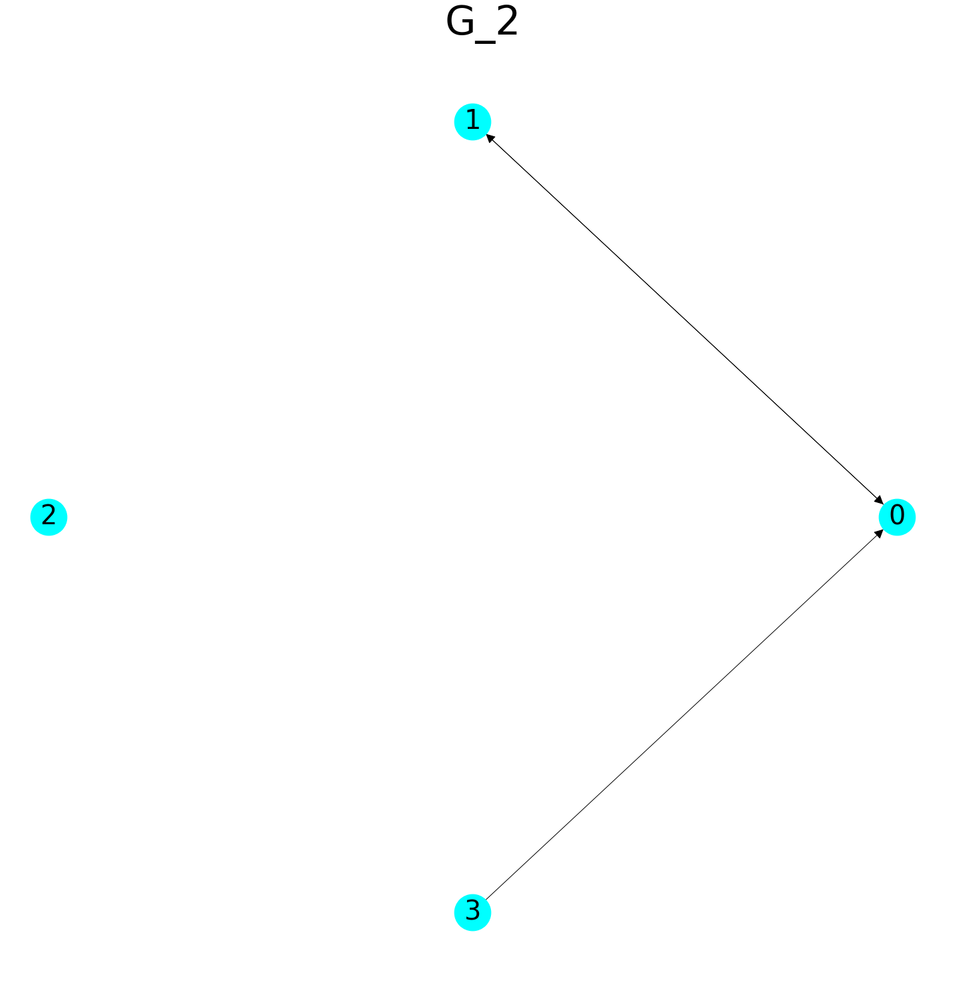

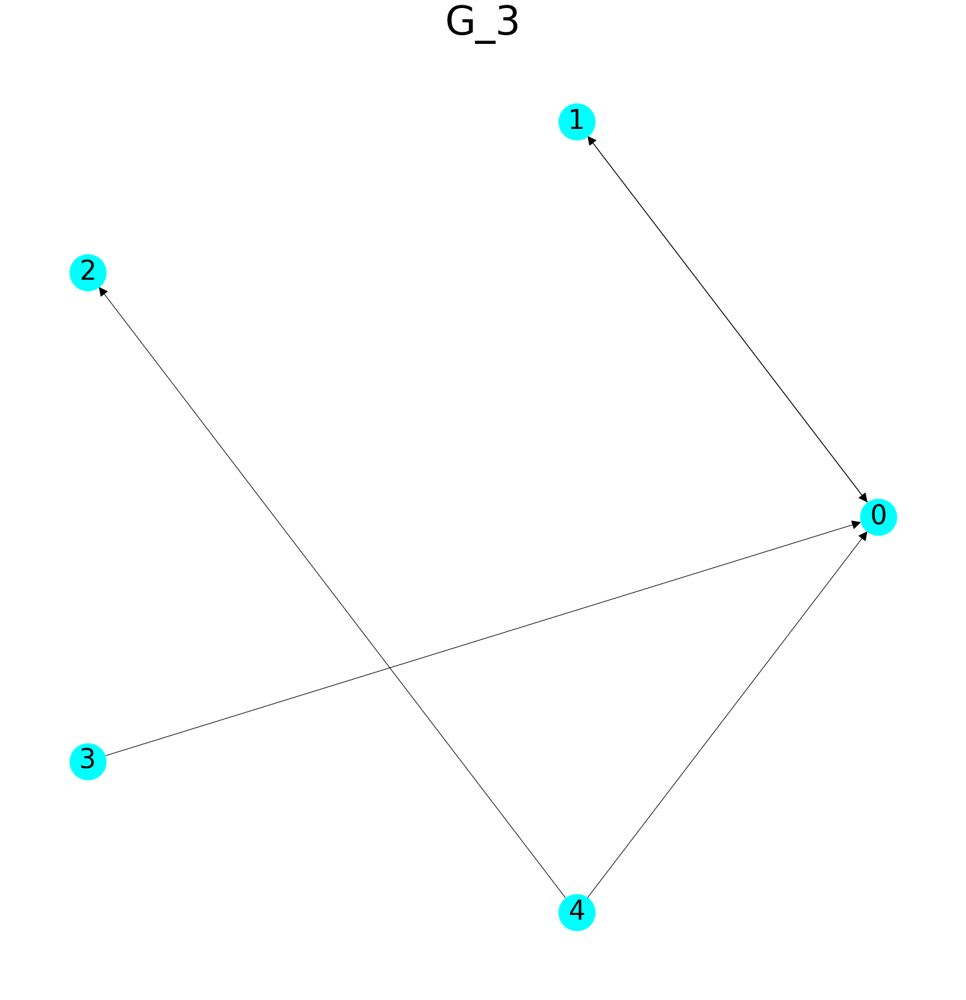

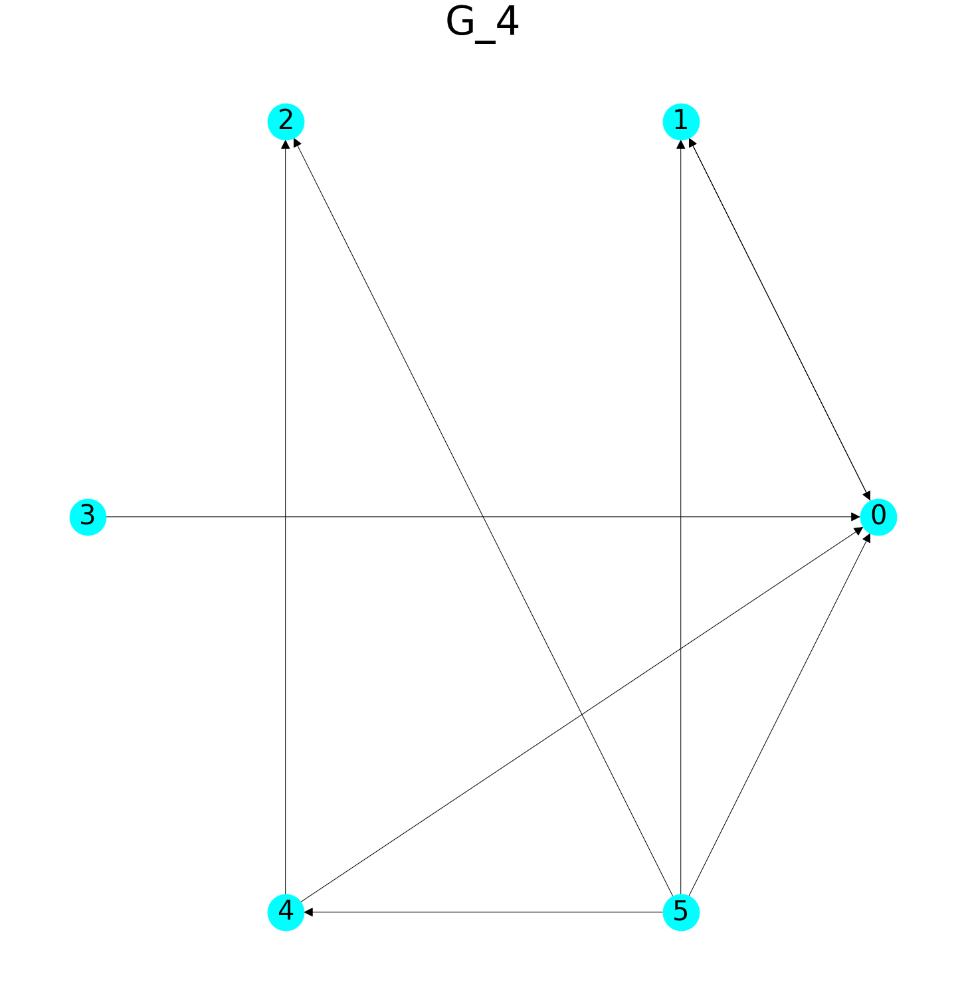

...

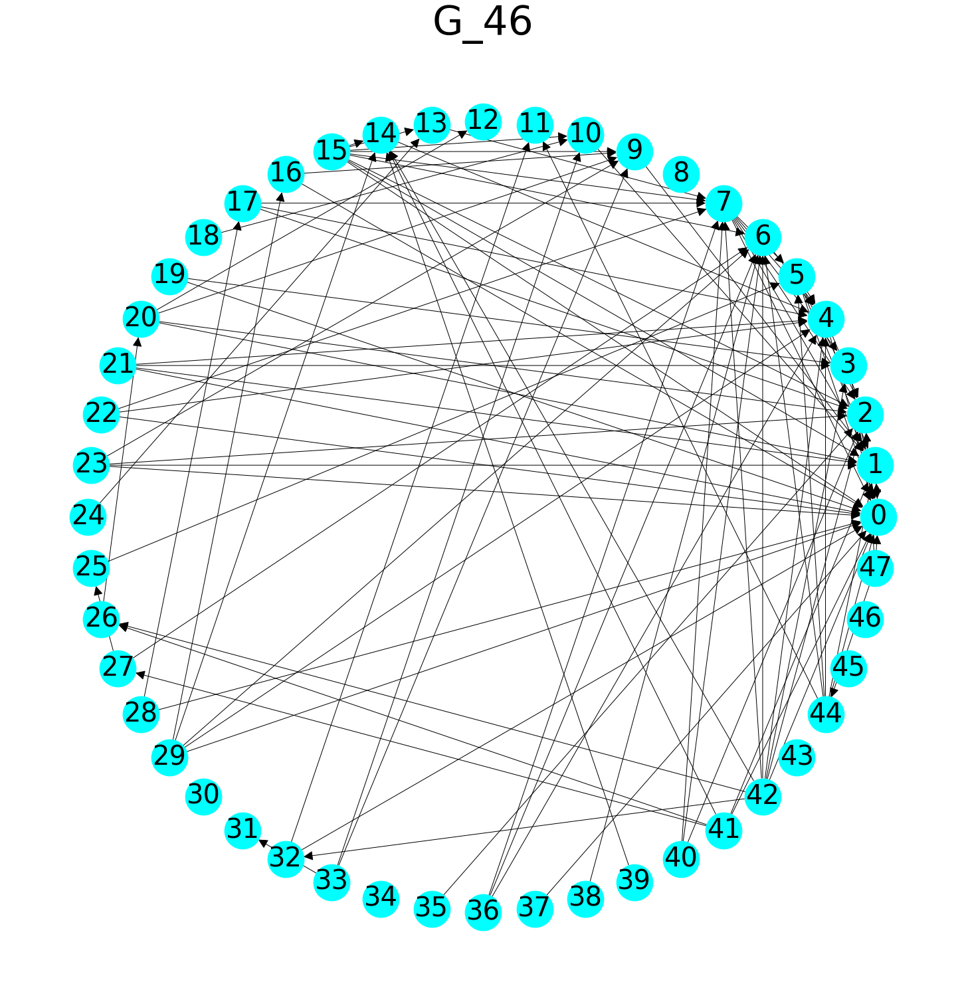

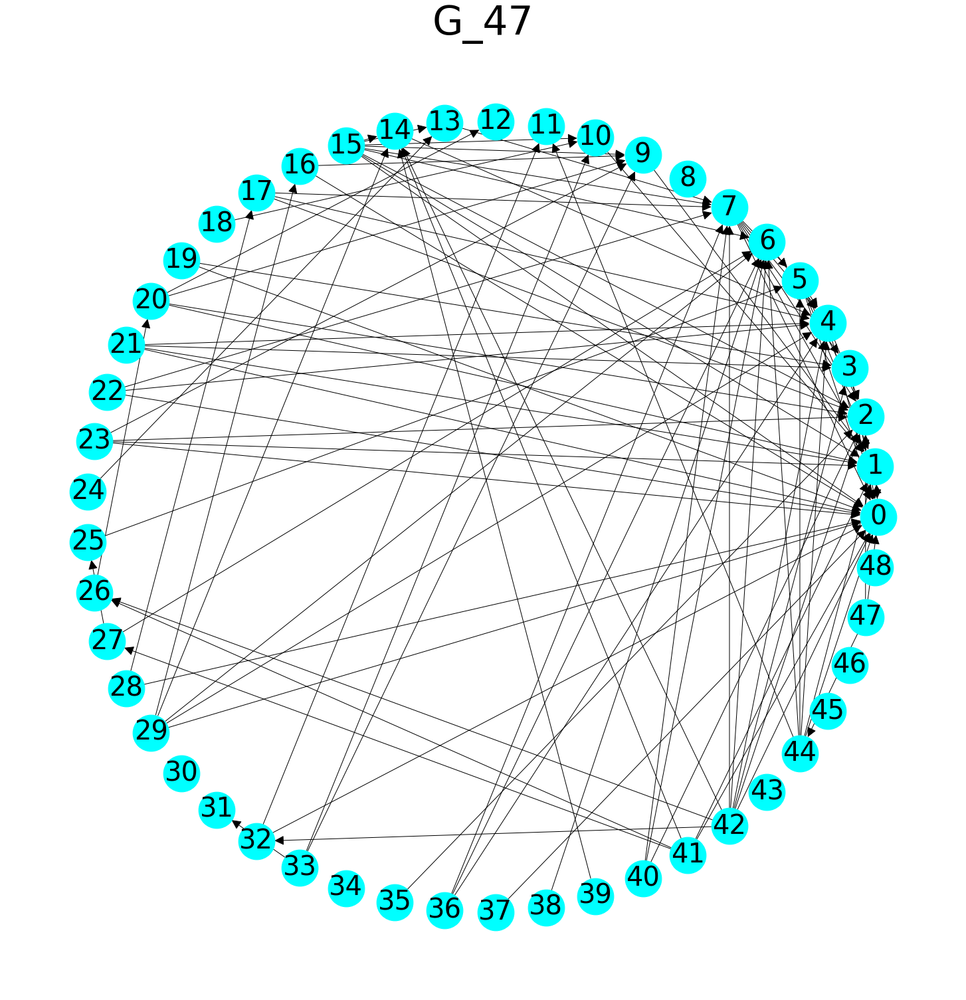

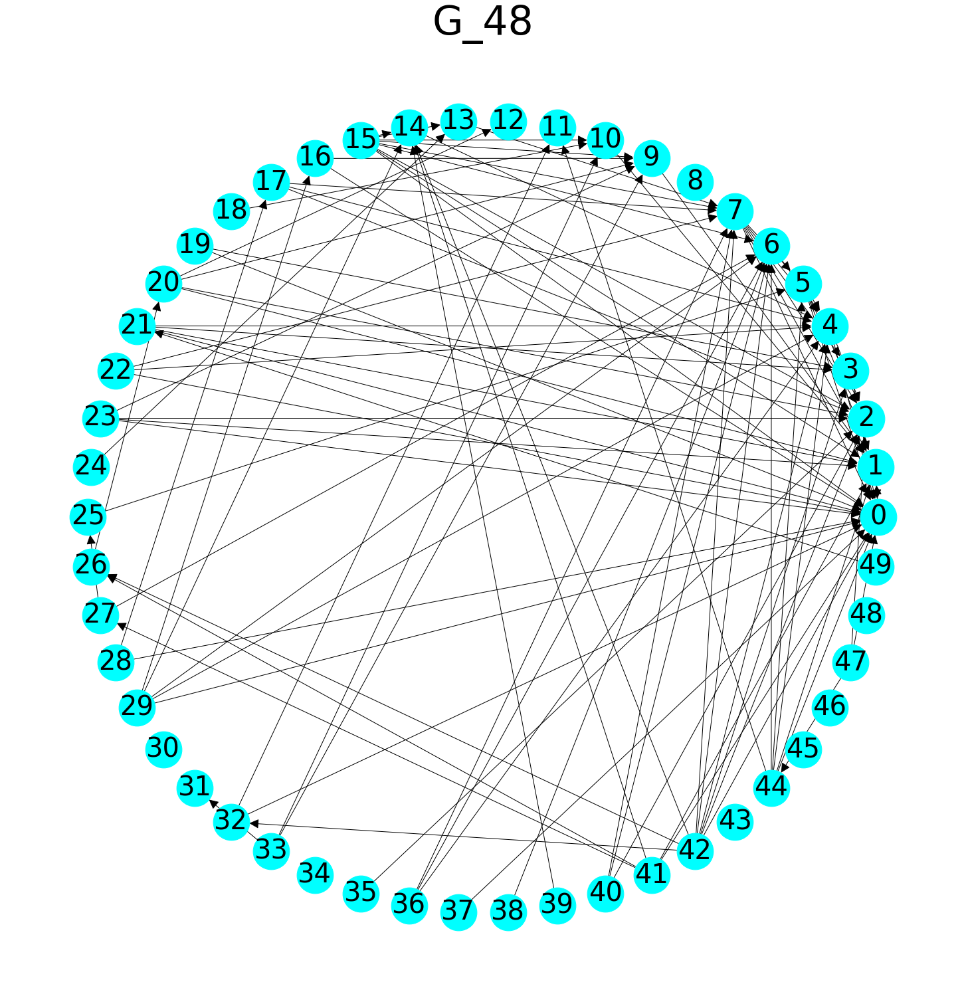

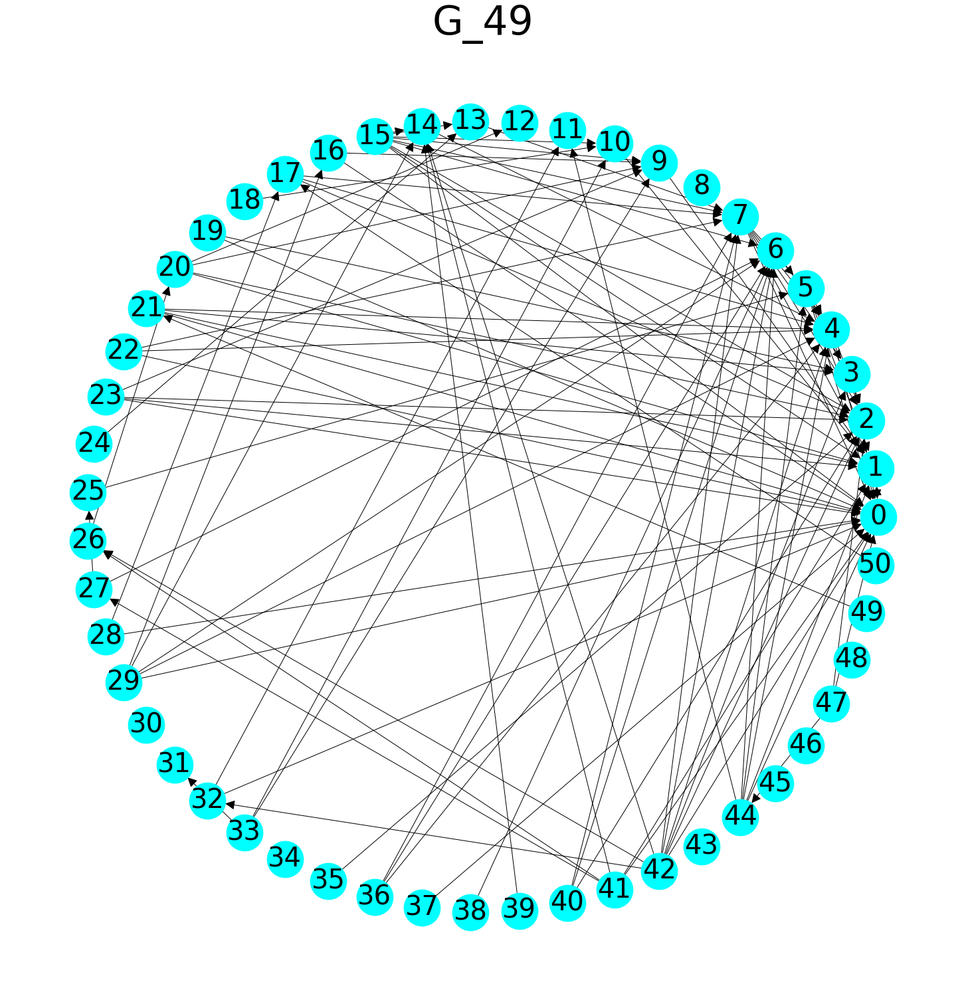

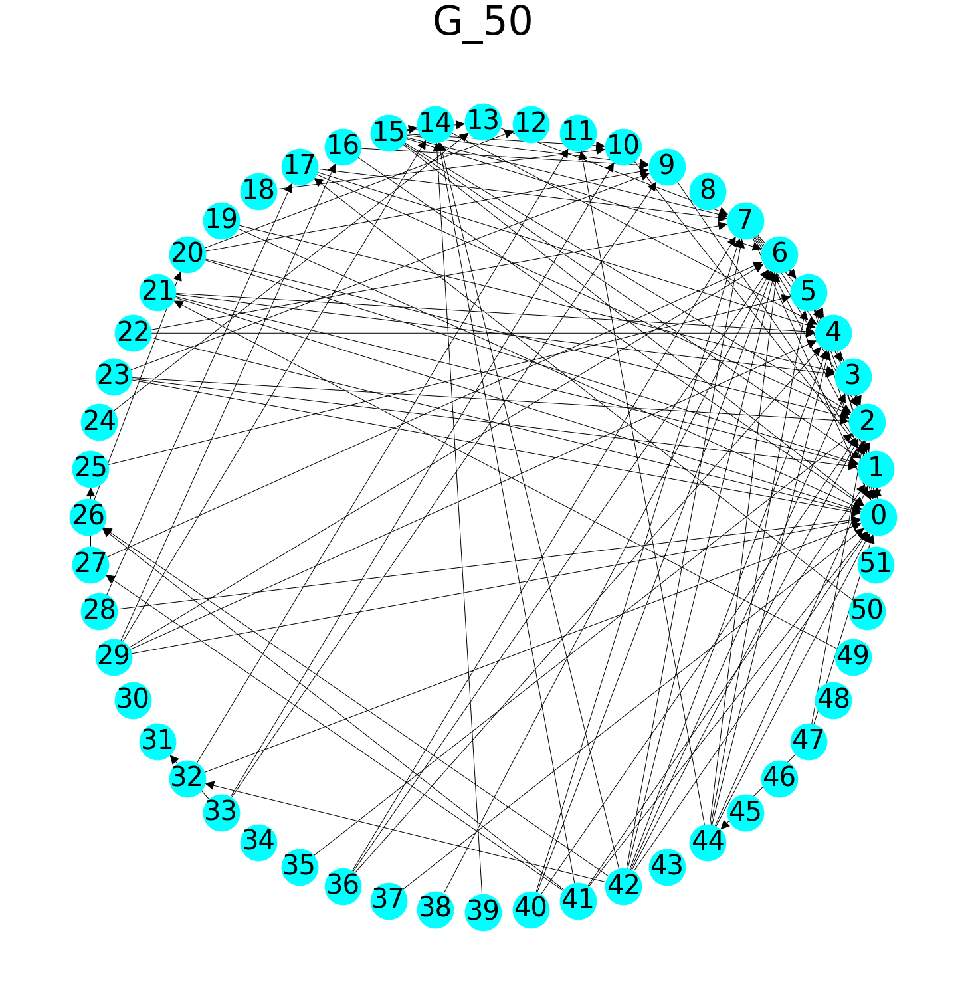

In [20]:
demo = True # print the graph at timestep t.

# Preferential attachment
GPA = nx.DiGraph()
# GPA is initialized to G0, containing two nodes connected to each other
GPA.add_edges_from([(0,1),(1,0)])

if demo:
    warnings.simplefilter(action='ignore', category=RuntimeWarning)
    t = 0
    plt.figure(figsize=(20,20))
    pos = nx.circular_layout(GPA)
    nx.draw(GPA, pos, node_color='#00ffff', arrowsize=30, node_size=3000, font_size=40, with_labels=True)
    plt.title("G_" + str(t), fontsize=60)
    
# compute out degree distribution of real citation graph

# degree sequence contains the out degree of nodes ordered from larger to smaller
degree_sequence = sorted([d for n, d in G.out_degree()], reverse=True) 
# count for each out-degree value, how many nodes have that out-degree
# degreeCount is a list of tuples (degree value, number of nodes)
degreeCount = collections.Counter(degree_sequence)
# zip() returns an iterator of tuples where the first item in each passed tuple 
# is paired together, the second item in each passed tuple are paired together
# and so on.
# In this way we obtain deg, which is the tuple of degree values, and
# cnt which is the tuple of the counts.

deg, cnt = zip(*degreeCount.items())
deg_distr = np.array(cnt)/sum(cnt)

print("Degree values in the network:", deg)
print("Counter for each degree", cnt)
print("Degree frequency", deg_distr)

# set a, the intrinsic probability of a node to be selected as a neighbor 
# from new nodes
a = 2

# add the remaining nodes one at a time
for node in range(2,n_nodes_cit):
    # compute degree of new node according to deg_distr (degree distribution
    # of the real citation graph).
    # the min guarantees that the new node is not assigned a degree
    # larger than the current size of the preferential attachment graph
    degree = min(np.random.choice(deg,p=deg_distr), len(GPA)) 
    # choose `degree` neighbors for node to connect to according to their 
    # in-degree in the current approximation GPA.
    # compute updated in degree sequence
    in_deg_PA = [d for n, d in GPA.in_degree()] 
    # add a so that also node with 0 in-degree have non-zero probability
    # of being chosen
    in_deg_PA = np.array(in_deg_PA)+a 
    # normalize to obtain a probability distribution
    in_deg_PA = in_deg_PA/sum(in_deg_PA)
    # replace=False guarantees no neighbor is chosen twice
    neighbors = np.random.choice(np.arange(len(GPA)), p=in_deg_PA, size=degree, replace=False)
    # add the new node (new node is added even if its out-degree is zero)
    GPA.add_node(node)
    # add the new links 
    for neigh in neighbors:
        GPA.add_edge(node,neigh) 
        
    if demo:
        t += 1
        if t<=50:
            plt.figure(figsize=(20,20))
            pos = nx.circular_layout(GPA)
            nx.draw(GPA, pos, node_color='#00ffff', arrowsize=30, node_size=3000, font_size=40, with_labels=True)
            plt.title("G_" + str(t), fontsize=60)
       